In [1]:
import sys
sys.path.append("..")
from config import *
from scripts.wafer_circle_clustering import *
from scripts.wafer_mapping import *
import pickle
import os
import json
from sklearn.neighbors import NearestNeighbors

In [2]:
wafer_images = {
    "0010304_Au-Pd-Pt-Rh": Au_Pd_Pt_Rh_photo_0010304,
    "0010403_Ag-Au-Cu-Pd-Pt": Ag_Au_Cu_Pd_Pt_photo_0010403,
    "0010311_Au-Pd-Pt-Rh-Ru": Au_Pd_Pt_Rh_Ru_photo_0010311,
    "0010275_Ag-Au-Pd-Pt-Rh_RT": Ag_Au_Pd_Pt_Rh_RT_photo_0010275,
    "0010272_Ag-Au-Pd": Ag_Au_Pd_photo_0010272,
    '0010374_Ir-Pd-Pt-Rh-Ru':Ir_Pd_Pt_Rh_Ru_photo_0010374,
    '0010402_Ag-Au-Pd-Pt': Ag_Au_Pd_Pt_photo_0010402, 
    '0010399_Au-Cu-Pd-Pt': Au_Cu_Pd_Pt_photo_0010399
}

# Base output folder
base_output = Wafer_Output_Dir

 Processing 0010304_Au-Pd-Pt-Rh ...


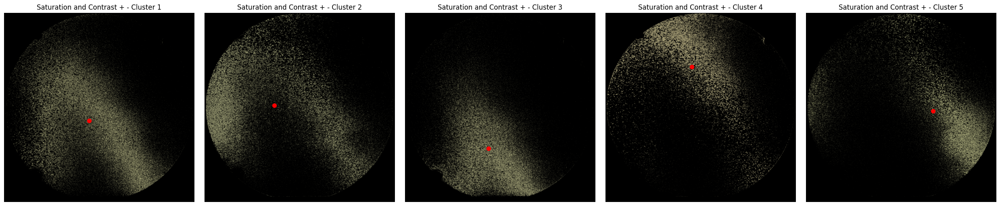

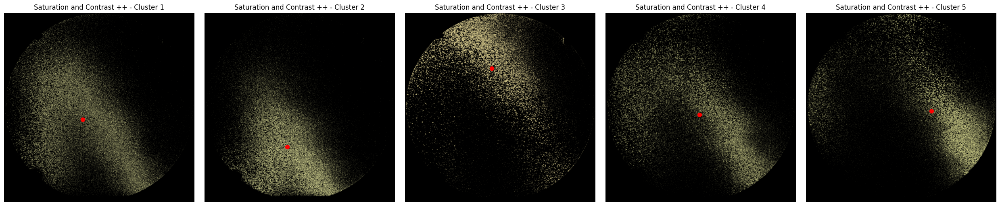

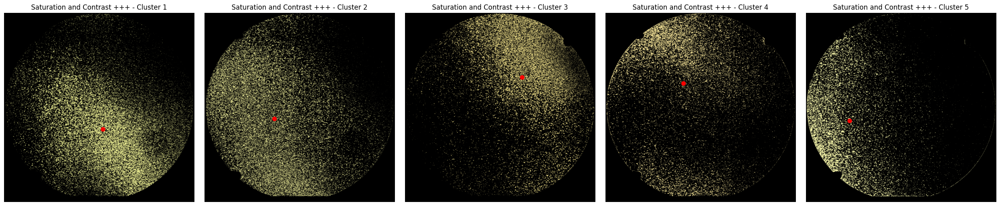

 Processing 0010403_Ag-Au-Cu-Pd-Pt ...


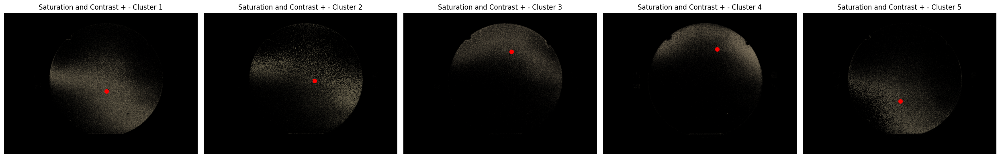

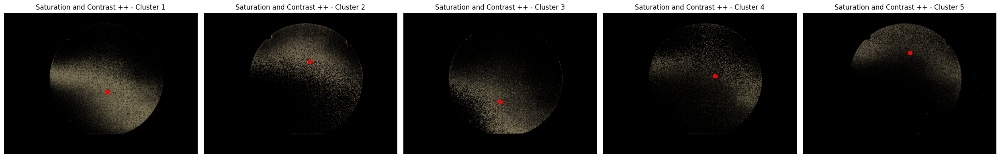

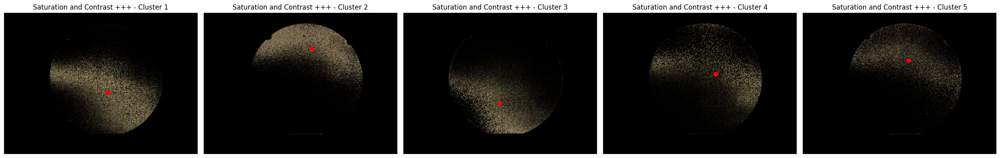

 Processing 0010311_Au-Pd-Pt-Rh-Ru ...


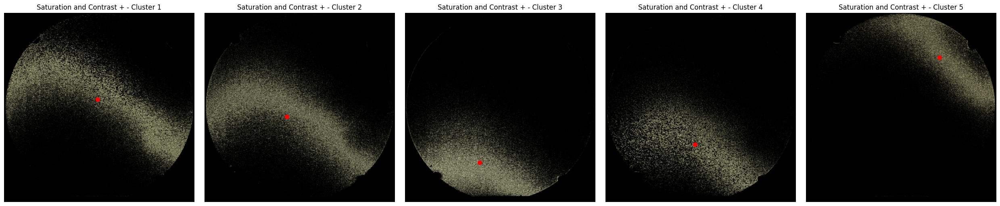

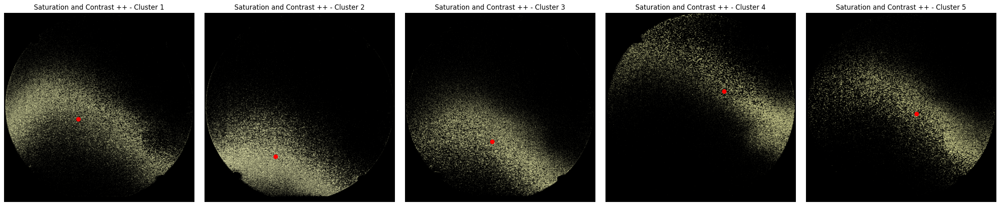

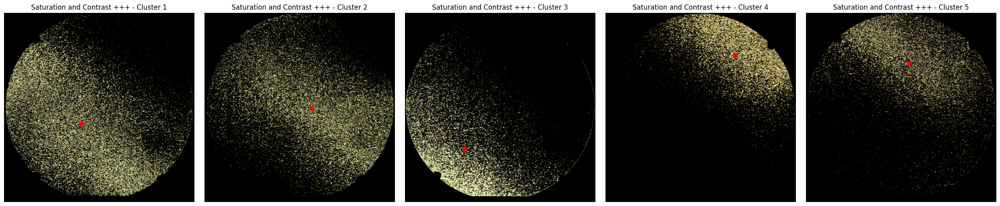

 Processing 0010275_Ag-Au-Pd-Pt-Rh_RT ...


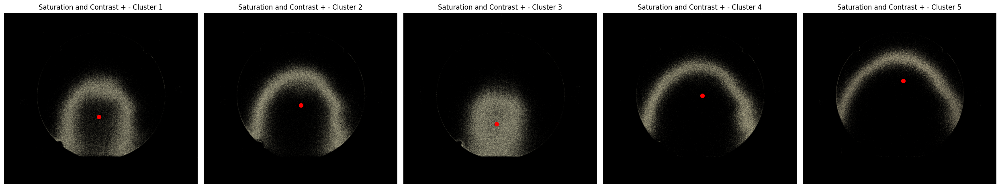

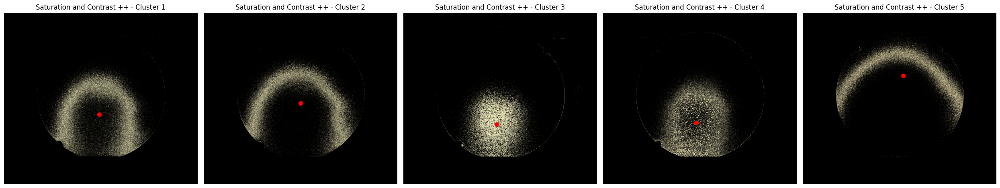

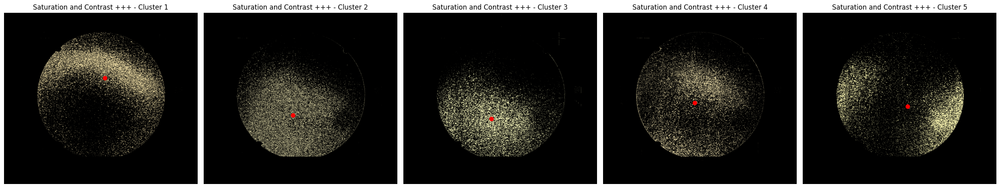

 Processing 0010272_Ag-Au-Pd ...


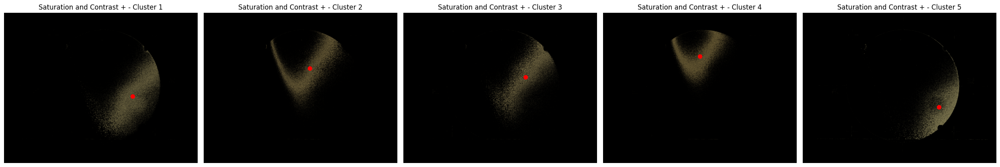

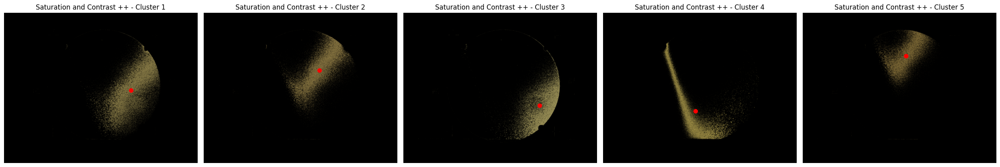

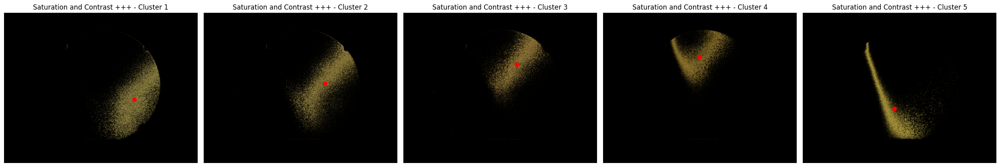

 Processing 0010374_Ir-Pd-Pt-Rh-Ru ...


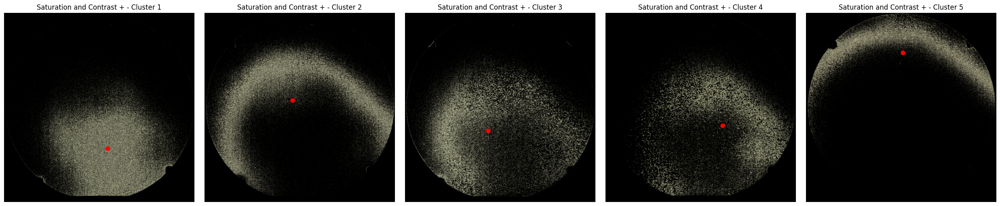

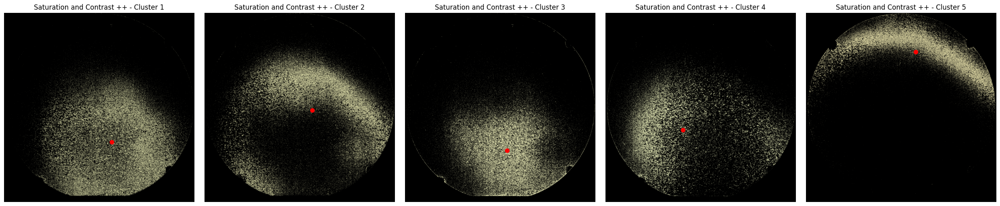

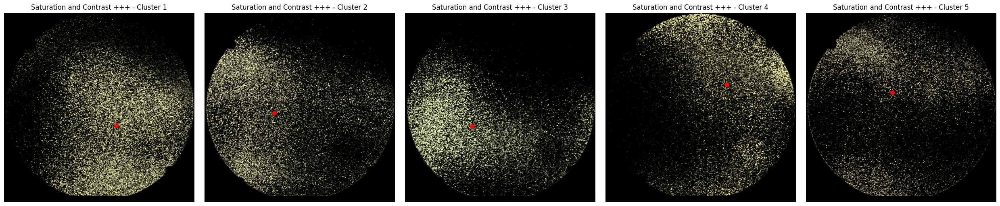

 Processing 0010402_Ag-Au-Pd-Pt ...


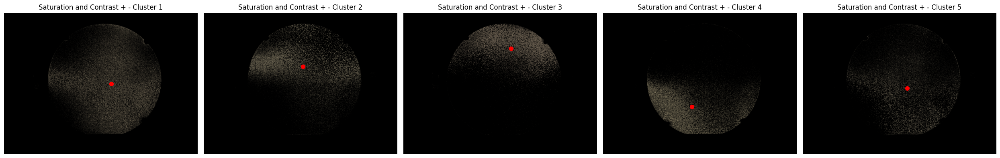

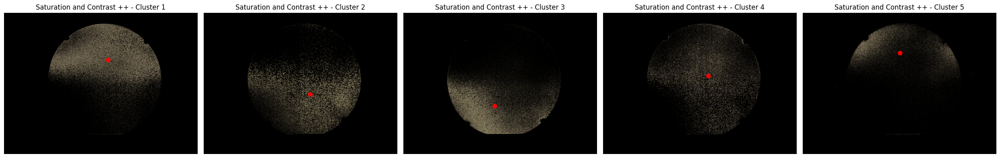

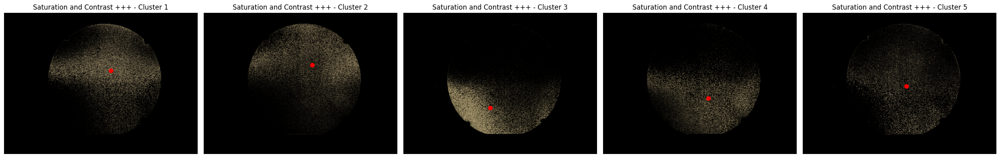

 Processing 0010399_Au-Cu-Pd-Pt ...


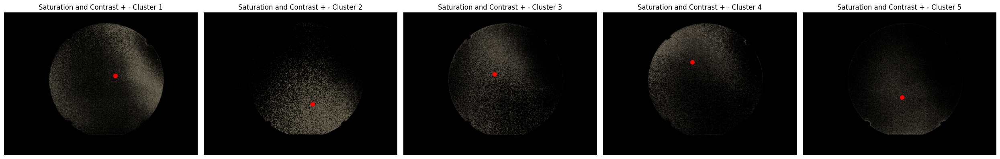

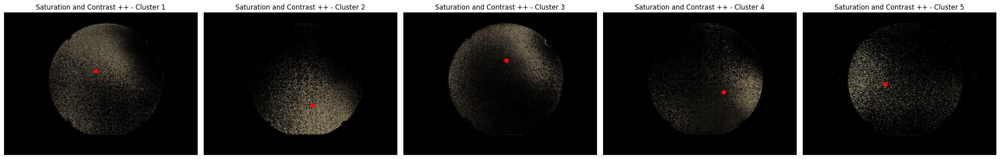

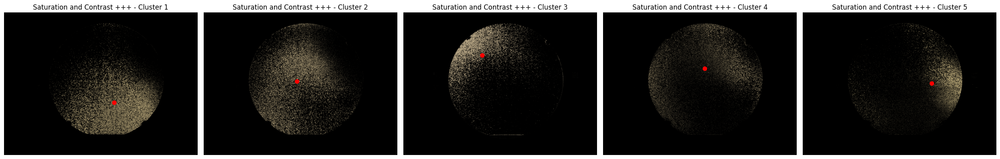

In [3]:
# Process all images
for name, image_path in wafer_images.items():
    output_folder = os.path.join(base_output, name)
    print(f" Processing {name} ...")
    process_wafer_image_saturation_black(image_path, save_folder=output_folder, k=18)


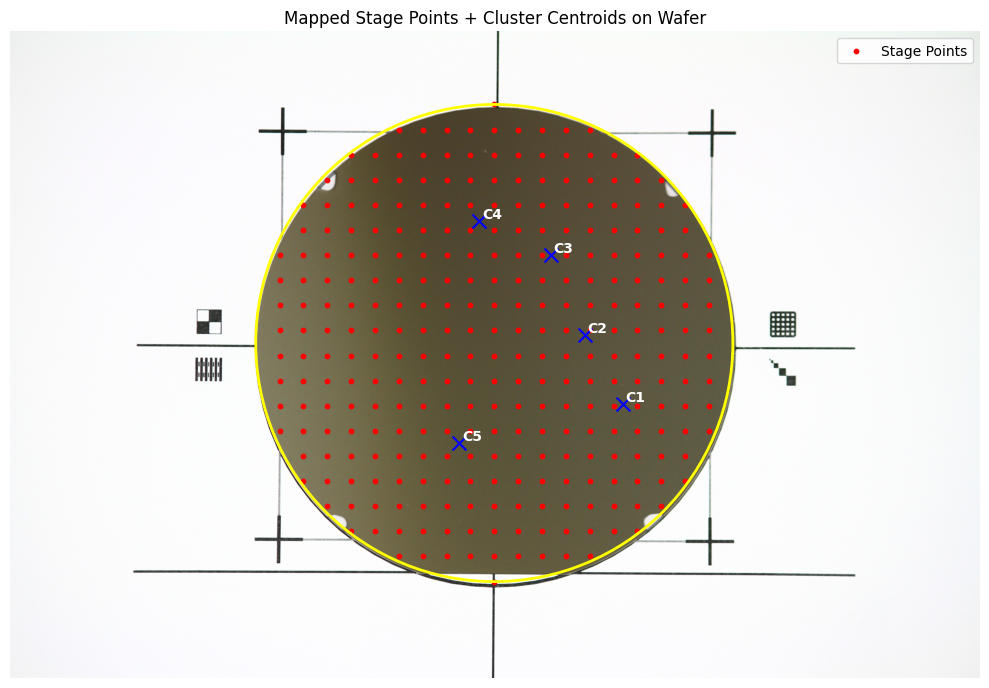

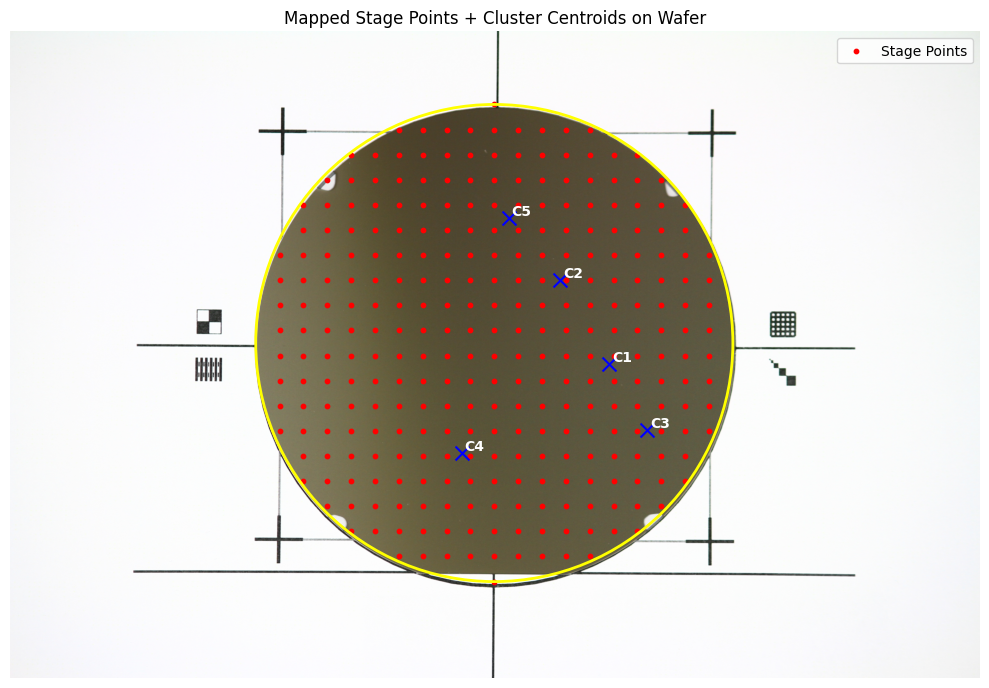

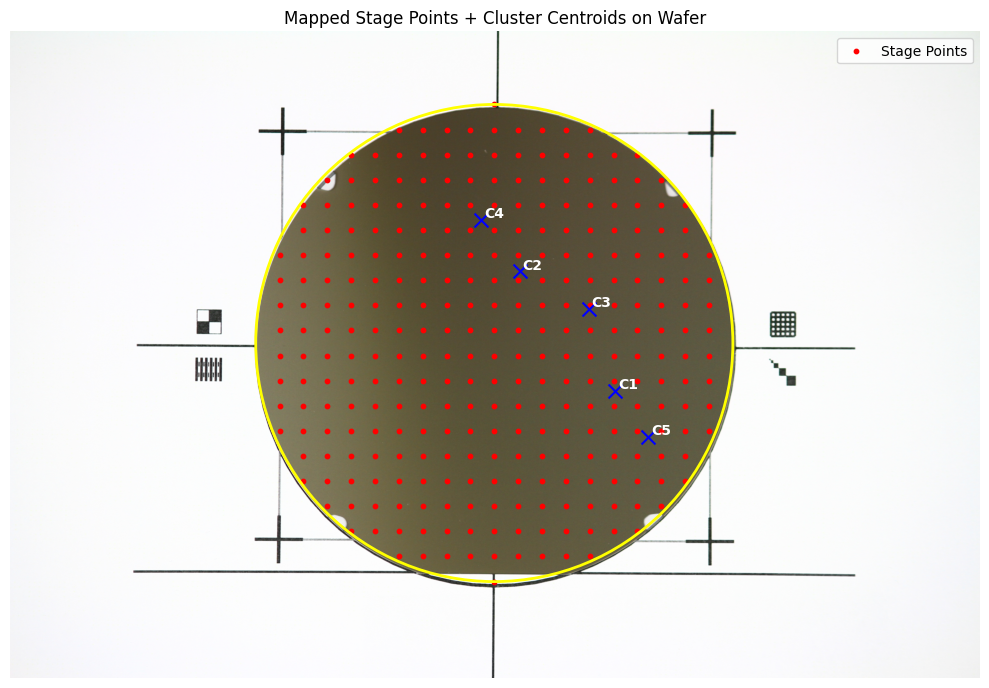

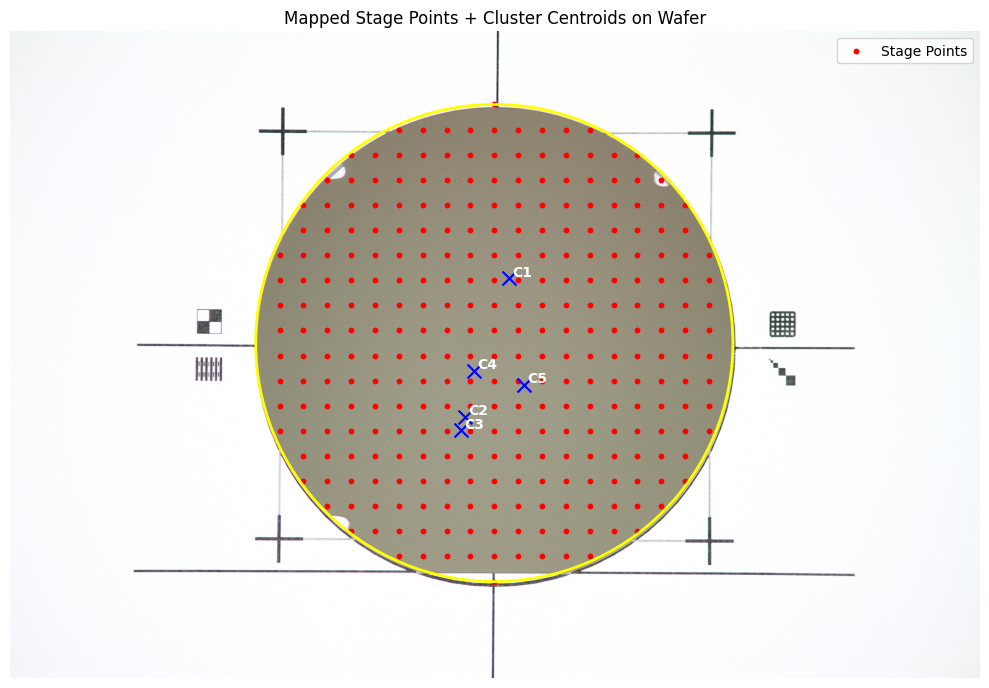

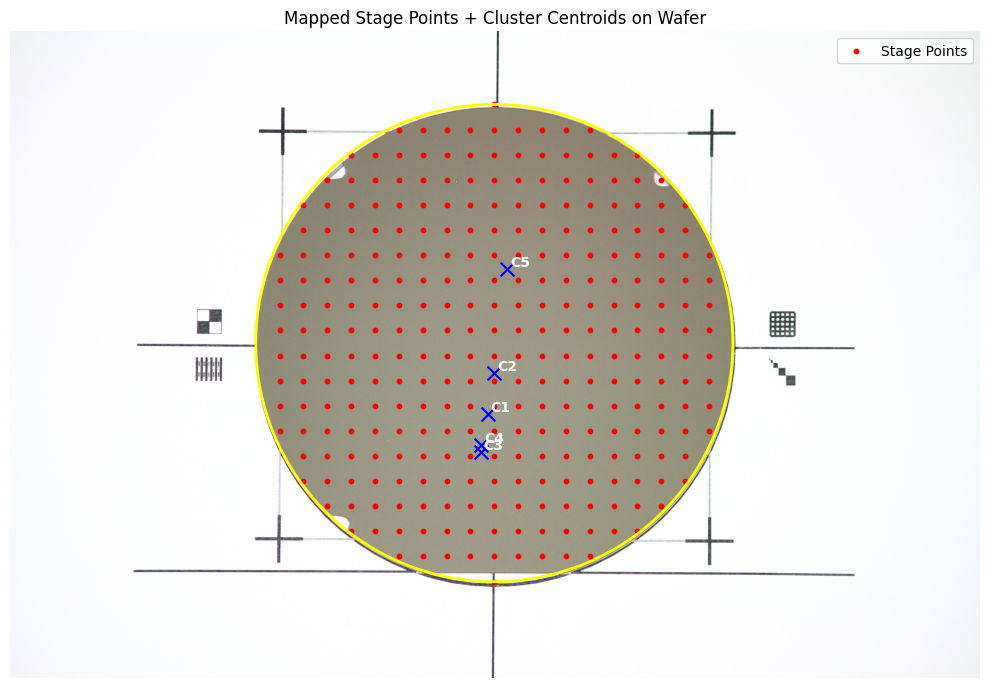

...

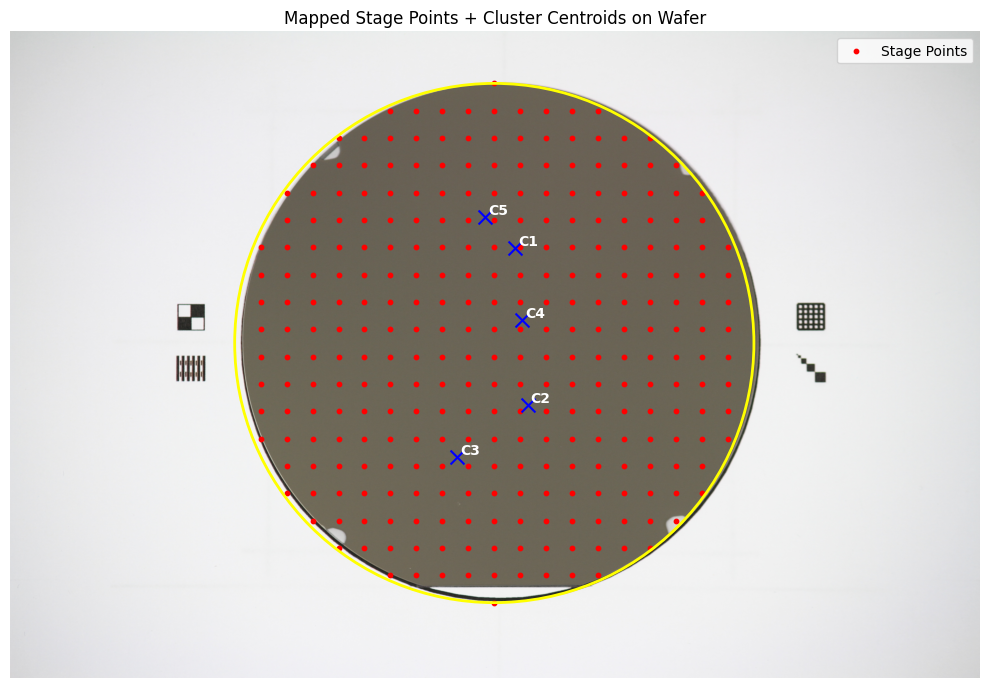

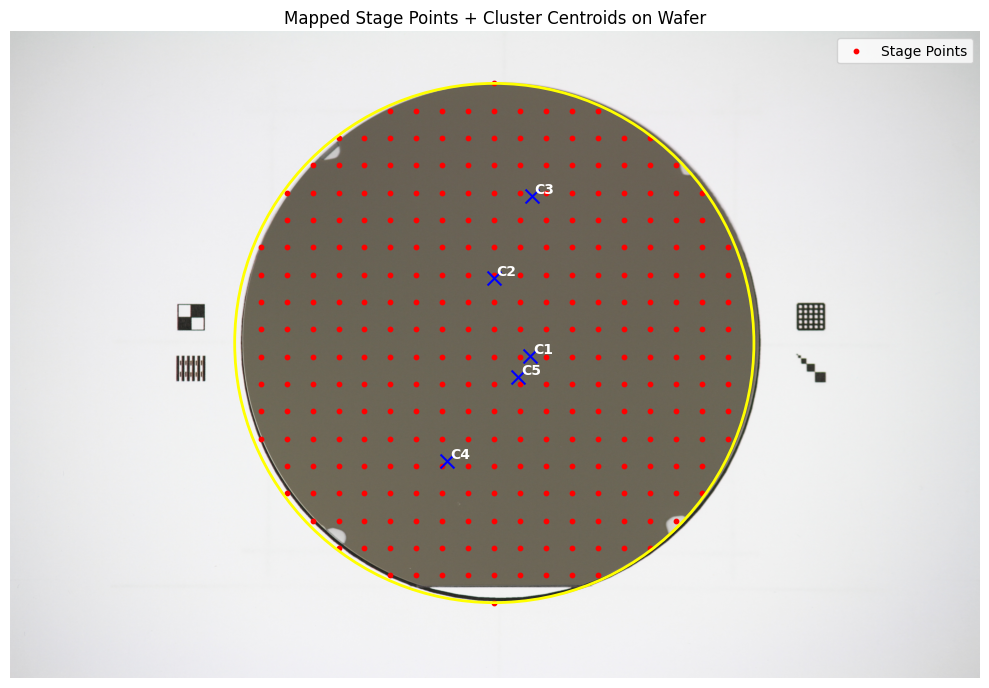

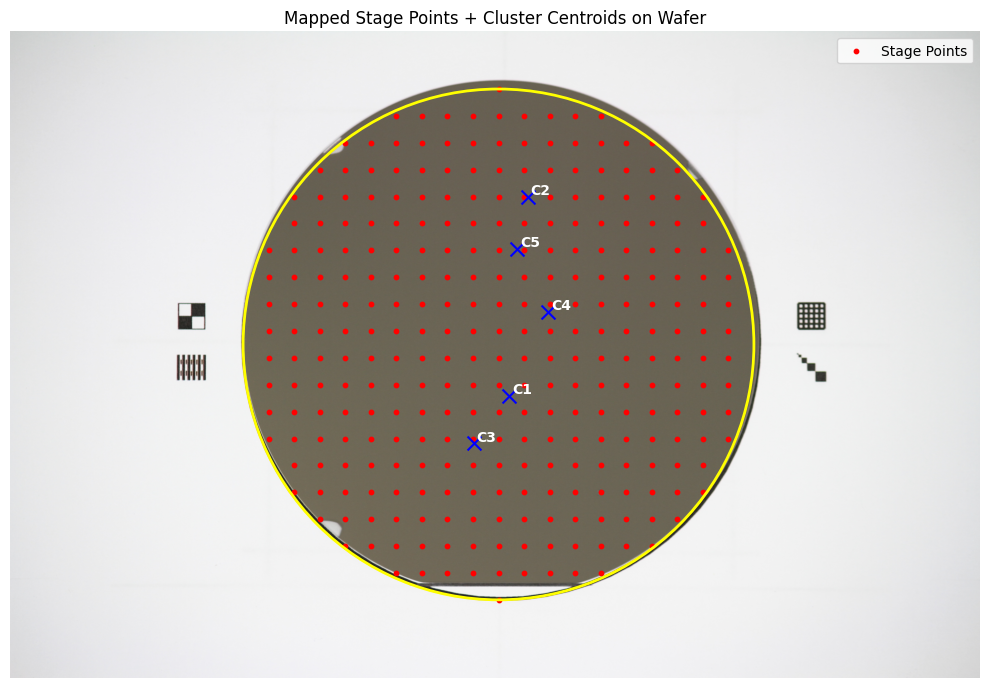

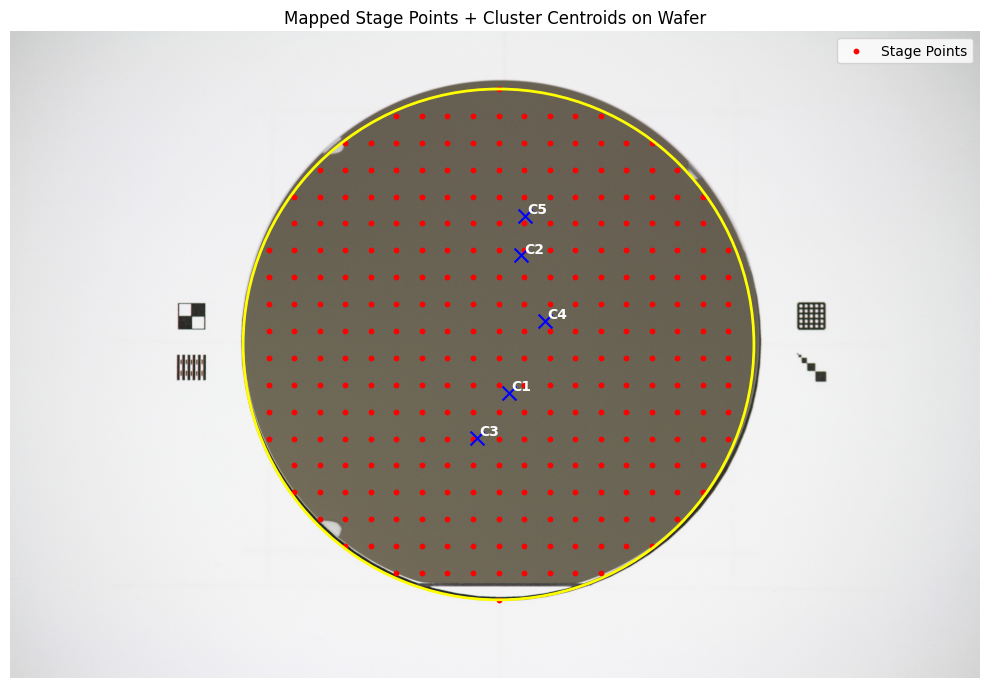

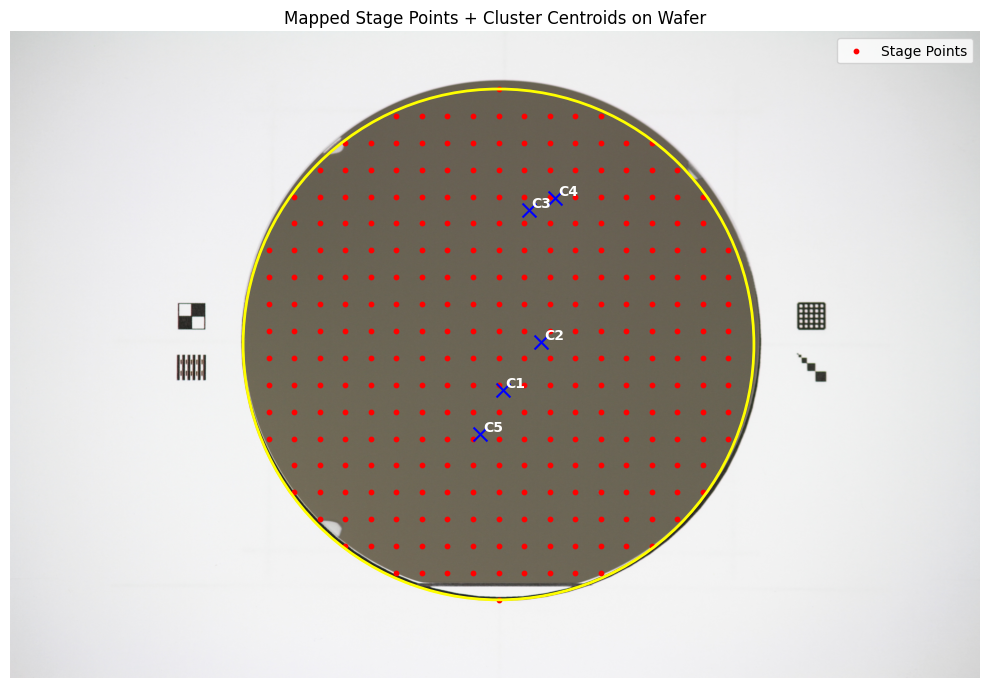

In [4]:
# === Setup ===
wafer_output_dir = Wafer_Output_Dir
centroids_mapped = {}

# CSV path for ALL stage points to get the x, y coordinates
csv_path = DATASET_10403_Ag_Au_Cu_Pd_Pt_RT

# Wafer images mapping
wafer_images = {
    "0010403": Ag_Au_Cu_Pd_Pt_photo_0010403,
    "0010304": Au_Pd_Pt_Rh_photo_0010304,
    "0010311": Au_Pd_Pt_Rh_Ru_photo_0010311,
    "0010275": Ag_Au_Pd_Pt_Rh_RT_photo_0010275,
    "0010272": Ag_Au_Pd_photo_0010272,
    "0010374": Ir_Pd_Pt_Rh_Ru_photo_0010374,
    "0010399":Au_Cu_Pd_Pt_photo_0010399,
    "0010402":Ag_Au_Pd_Pt_photo_0010402
}

# Default wafer center and radius
default_x_center = 1725
default_y_center = 1110
default_radius = 850

# Custom radius overrides
wafer_radii = {
    "0010403": 910,   # <- 0010403 needs 910
    "0010304": 920,   # <- 0010304 needs 920
    "0010311": 920,   # <- 0010311 needs 920
    "0010374": 925,   # <- 0010374 needs 925
    "0010399": 925,   # <- 0010399 needs 925
    "0010402": 925,   # <- 0010402 needs 925
}

# Custom center overrides
wafer_centers = {
    "0010403": (1740, 1115)  # <- 0010403 needs center shift
}

# === Load Stage Points ===
df = pd.read_csv(csv_path)
x_stage = df['x'].values
y_stage = df['y'].values

x_center_stage = (x_stage.max() + x_stage.min()) / 2
y_center_stage = (y_stage.max() + y_stage.min()) / 2
x_range = x_stage.max() - x_stage.min()
y_range = y_stage.max() - y_stage.min()

x_norm = (x_stage - x_center_stage) / (x_range / 2)
y_norm = (y_stage - y_center_stage) / (y_range / 2)

# === Process each wafer ===
for wafer_name in os.listdir(wafer_output_dir):
    wafer_folder = os.path.join(wafer_output_dir, wafer_name)
    if not os.path.isdir(wafer_folder):
        continue

    wafer_id = wafer_name.split("_")[0]
    centroids_mapped[wafer_name] = {}

    image_path = wafer_images.get(wafer_id)
    if image_path is None:
        print(f" No image found for {wafer_id}, skipping.")
        continue

    # Set wafer-specific radius
    wafer_radius = wafer_radii.get(wafer_id, default_radius)

    # Set wafer-specific center
    x_center, y_center = wafer_centers.get(wafer_id, (default_x_center, default_y_center))

    # Map stage points with correct center and radius
    x_scaled = x_norm * wafer_radius
    y_scaled = y_norm * wafer_radius

    x_pixel = x_center + x_scaled
    y_pixel = y_center - y_scaled

    stage_points = np.vstack((x_pixel, y_pixel)).T

    nn_model = NearestNeighbors(n_neighbors=1)
    nn_model.fit(stage_points)

    for file in os.listdir(wafer_folder):
        if file.endswith("_centroids.pkl"):
            pkl_path = os.path.join(wafer_folder, file)
            with open(pkl_path, "rb") as f:
                centroids_data = pickle.load(f)

            if isinstance(centroids_data, tuple):
                centroids, offsets = centroids_data
                corrected_centroids = [(float(cx + offsets["left"]), float(cy + offsets["top"])) for (cx, cy) in centroids]
            else:
                corrected_centroids = [(float(cx), float(cy)) for (cx, cy) in centroids_data]

            corrected_centroids_np = np.array(corrected_centroids)

            # Find nearest stage indices
            distances, nearest_indices = nn_model.kneighbors(corrected_centroids_np)

            # Build output
            saturation_level = file.replace("_centroids.pkl", "").lower()
            centroids_list = []
            for (cx, cy), idx in zip(corrected_centroids, nearest_indices.flatten()):
                centroids_list.append({
                    "pixel": [cx, cy],
                    "nearest_stage_index": int(idx)
                })

            centroids_mapped[wafer_name][saturation_level] = centroids_list

            # Plot overlay
            overlay_name = file.replace("_centroids.pkl", "_mapped_overlay.png")
            save_path = os.path.join(wafer_folder, overlay_name)

     
            map_centroids_to_wafer(
                image_path=image_path,
                csv_path=csv_path,
                centroids=corrected_centroids,
                x_center=x_center,
                y_center=y_center,
                wafer_radius_pixels=wafer_radius,
                save_path=save_path
            )

# === Save final JSON ===
with open(MAPPED_CENTROIDS_JSON, "w") as f:
    json.dump(centroids_mapped, f, indent=4)
